# Project 4 - Unsupervised Machine Learning

data source : https://archive.ics.uci.edu/dataset/602/dry+bean+dataset

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff

sns.set_theme(palette="pastel")

pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

C:\Users\USER\AppData\Roaming\Python\Python311\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [2]:
data = pd.read_excel('data/Dry_Bean_Dataset.xlsx')
data

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272750,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,42097,759.696,288.721612,185.944705,1.552728,0.765002,42508,231.515799,0.714574,0.990331,0.916603,0.801865,0.006858,0.001749,0.642988,0.998385,DERMASON
13607,42101,757.499,281.576392,190.713136,1.476439,0.735702,42494,231.526798,0.799943,0.990752,0.922015,0.822252,0.006688,0.001886,0.676099,0.998219,DERMASON
13608,42139,759.321,281.539928,191.187979,1.472582,0.734065,42569,231.631261,0.729932,0.989899,0.918424,0.822730,0.006681,0.001888,0.676884,0.996767,DERMASON
13609,42147,763.779,283.382636,190.275731,1.489326,0.741055,42667,231.653248,0.705389,0.987813,0.907906,0.817457,0.006724,0.001852,0.668237,0.995222,DERMASON


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             13611 non-null  int64  
 1   Perimeter        13611 non-null  float64
 2   MajorAxisLength  13611 non-null  float64
 3   MinorAxisLength  13611 non-null  float64
 4   AspectRation     13611 non-null  float64
 5   Eccentricity     13611 non-null  float64
 6   ConvexArea       13611 non-null  int64  
 7   EquivDiameter    13611 non-null  float64
 8   Extent           13611 non-null  float64
 9   Solidity         13611 non-null  float64
 10  roundness        13611 non-null  float64
 11  Compactness      13611 non-null  float64
 12  ShapeFactor1     13611 non-null  float64
 13  ShapeFactor2     13611 non-null  float64
 14  ShapeFactor3     13611 non-null  float64
 15  ShapeFactor4     13611 non-null  float64
 16  Class            13611 non-null  object 
dtypes: float64(1

In [4]:
data.isnull().sum()

Area               0
Perimeter          0
MajorAxisLength    0
MinorAxisLength    0
AspectRation       0
Eccentricity       0
ConvexArea         0
EquivDiameter      0
Extent             0
Solidity           0
roundness          0
Compactness        0
ShapeFactor1       0
ShapeFactor2       0
ShapeFactor3       0
ShapeFactor4       0
Class              0
dtype: int64

# Exploratory Data Analysis

c:\Users\USER\anaconda3\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\USER\AppData\Local\Temp\ipykernel_68444\2456656178.py:2: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


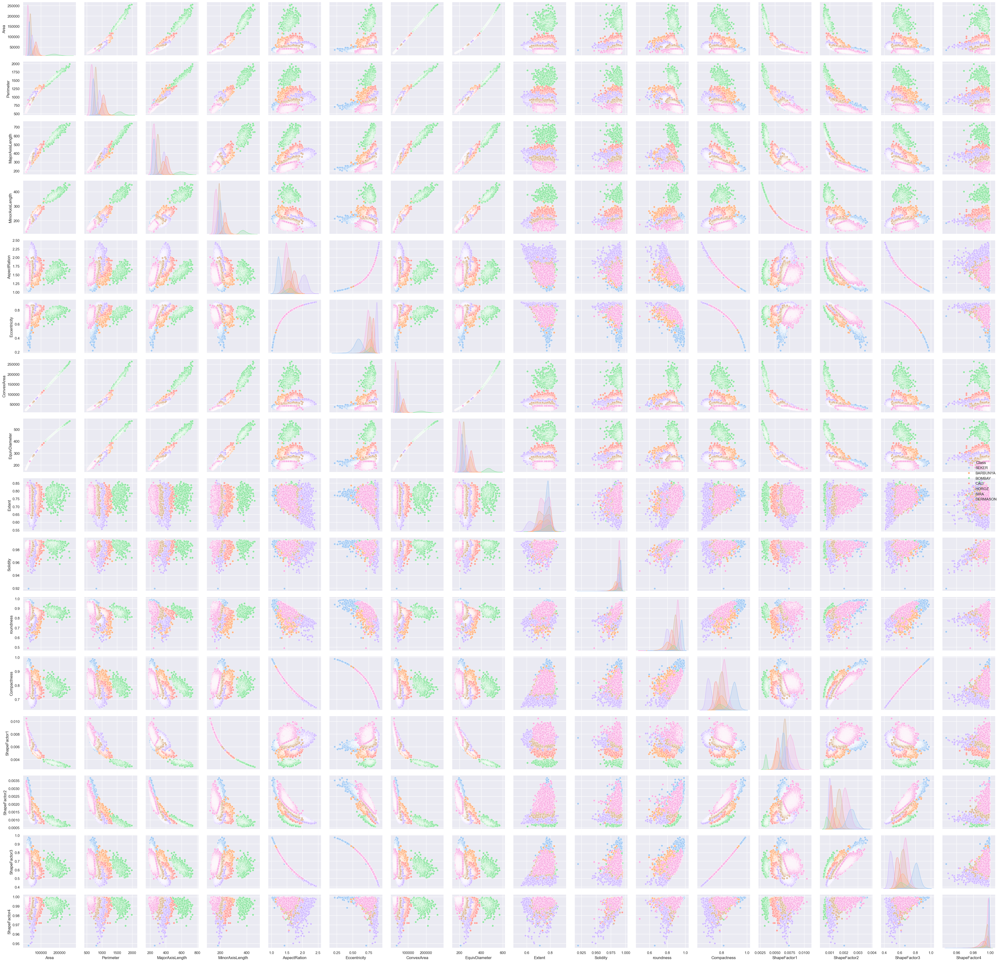

In [5]:
sns.pairplot(data, hue='Class')
plt.tight_layout()

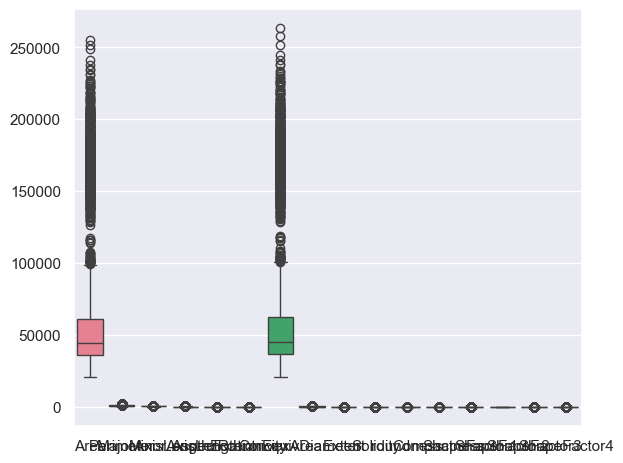

In [6]:
sns.boxplot(data)

plt.tight_layout()
plt.show()

# Feature Engineering

In [7]:
df_skew = data.drop('Class',axis=1).skew().to_frame('Skewness')
display(df_skew[df_skew['Skewness'] > .75])
display(df_skew[df_skew['Skewness'] < -.75])

,Skewness
Area,2.952931
Perimeter,1.626124
MajorAxisLength,1.357815
MinorAxisLength,2.238211
ConvexArea,2.941821
EquivDiameter,1.948958


,Skewness
Eccentricity,-1.062824
Extent,-0.895348
Solidity,-2.550093
ShapeFactor4,-2.759483


In [8]:
high_skew_indices = df_skew[df_skew['Skewness'] > 0.75].index.values
low_skew_indices = df_skew[df_skew['Skewness'] < -0.75].index.values

combined_indices = np.concatenate((high_skew_indices, low_skew_indices))
combined_indices

array(['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
       'ConvexArea', 'EquivDiameter', 'Eccentricity', 'Extent',
       'Solidity', 'ShapeFactor4'], dtype=object)

In [9]:
from sklearn.preprocessing import PowerTransformer

skewed_data = data[combined_indices]
data_trans = data

transformer = PowerTransformer(method='box-cox')

temp = pd.DataFrame(transformer.fit_transform(skewed_data), columns=combined_indices)
data_trans[combined_indices] = temp[combined_indices]
data_trans

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,-1.571397,-1.688803,-1.996759,-0.685222,1.197191,-1.856936,-1.573016,-1.571397,0.159174,0.249764,0.958027,0.913358,0.007332,0.003147,0.834222,1.287266,SEKER
1,-1.523467,-1.372993,-2.249965,-0.334325,1.097356,-2.370929,-1.509413,-1.523467,0.681885,-0.816516,0.887034,0.953861,0.006979,0.003564,0.909851,1.113009,SEKER
2,-1.434910,-1.527191,-1.852350,-0.599726,1.209713,-1.786929,-1.439469,-1.434910,0.521982,0.505548,0.947849,0.908774,0.007244,0.003048,0.825871,1.501879,SEKER
3,-1.352138,-1.289303,-1.921978,-0.342391,1.153638,-2.094045,-1.306262,-1.352138,0.646211,-1.913219,0.903936,0.928329,0.007017,0.003215,0.861794,-0.624348,SEKER
4,-1.335138,-1.572804,-2.204741,-0.071072,1.060798,-2.516921,-1.344955,-1.335138,0.389833,1.058077,0.984877,0.970516,0.006697,0.003665,0.941900,1.566962,SEKER
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,-0.203728,-0.306422,-0.181223,-0.218592,1.552728,0.004477,-0.211398,-0.203728,-0.861261,0.814041,0.916603,0.801865,0.006858,0.001749,0.642988,1.087020,DERMASON
13607,-0.203448,-0.322072,-0.298200,-0.056830,1.476439,-0.349728,-0.212369,-0.203448,1.150507,0.994953,0.922015,0.822252,0.006688,0.001886,0.676099,0.992720,DERMASON
13608,-0.200790,-0.309086,-0.298813,-0.041348,1.472582,-0.368443,-0.207175,-0.200790,-0.580388,0.637641,0.918424,0.822730,0.006681,0.001888,0.676884,0.276368,DERMASON
13609,-0.200231,-0.277624,-0.268041,-0.071189,1.489326,-0.287768,-0.200412,-0.200231,-1.015067,-0.090612,0.907906,0.817457,0.006724,0.001852,0.668237,-0.312451,DERMASON


<Axes: >

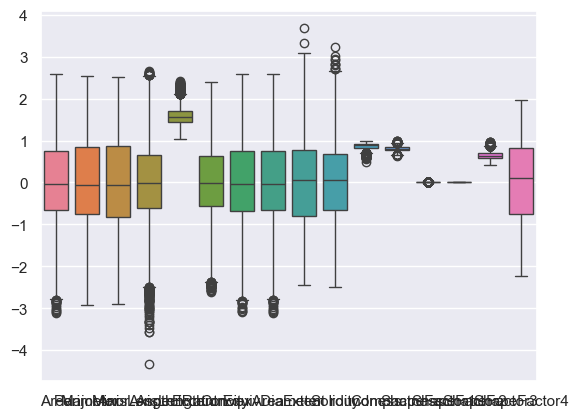

In [10]:
sns.boxplot(data_trans)

In [11]:
numerical_cols = data.select_dtypes('number').columns

In [12]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(data[numerical_cols])

data_scaled = pd.DataFrame(scaler.transform(data[numerical_cols]), columns=numerical_cols)
data_scaled

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
0,-1.571397,-1.688803,-1.996759,-0.685222,-1.565053,-1.856936,-1.573016,-1.571397,0.159174,0.249764,1.423867,1.839116,0.680786,2.402173,1.925723,1.287266
1,-1.523467,-1.372993,-2.249965,-0.334325,-1.969784,-2.370929,-1.509413,-1.523467,0.681885,-0.816516,0.231054,2.495449,0.367967,3.100893,2.689702,1.113009
2,-1.434910,-1.527191,-1.852350,-0.599726,-1.514291,-1.786929,-1.439469,-1.434910,0.521982,0.505548,1.252865,1.764843,0.603129,2.235091,1.841356,1.501879
3,-1.352138,-1.289303,-1.921978,-0.342391,-1.741618,-2.094045,-1.306262,-1.352138,0.646211,-1.913219,0.515049,2.081715,0.401718,2.515075,2.204250,-0.624348
4,-1.335138,-1.572804,-2.204741,-0.071072,-2.117993,-2.516921,-1.344955,-1.335138,0.389833,1.058077,1.874992,2.765330,0.118268,3.270983,3.013462,1.566962
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,-0.203728,-0.306422,-0.181223,-0.218592,-0.123703,0.004477,-0.211398,-0.203728,-0.861261,0.814041,0.727872,0.032433,0.261425,0.055630,-0.006086,1.087020
13607,-0.203448,-0.322072,-0.298200,-0.056830,-0.432979,-0.349728,-0.212369,-0.203448,1.150507,0.994953,0.818807,0.362794,0.110384,0.285117,0.328393,0.992720
13608,-0.200790,-0.309086,-0.298813,-0.041348,-0.448618,-0.368443,-0.207175,-0.200790,-0.580388,0.637641,0.758468,0.370533,0.104269,0.289204,0.336328,0.276368
13609,-0.200231,-0.277624,-0.268041,-0.071189,-0.380735,-0.287768,-0.200412,-0.200231,-1.015067,-0.090612,0.581753,0.285098,0.141906,0.228375,0.248973,-0.312451


<Axes: >

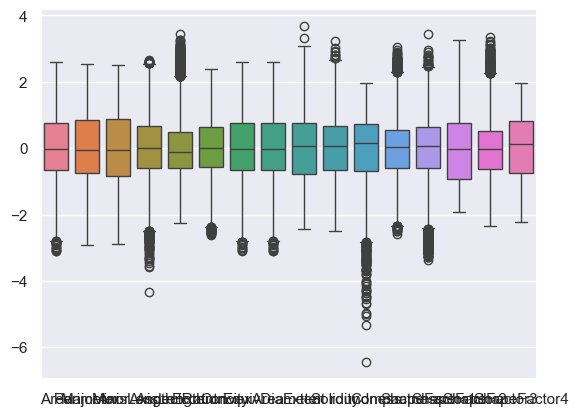

In [13]:
sns.boxplot(data_scaled)

c:\Users\USER\anaconda3\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


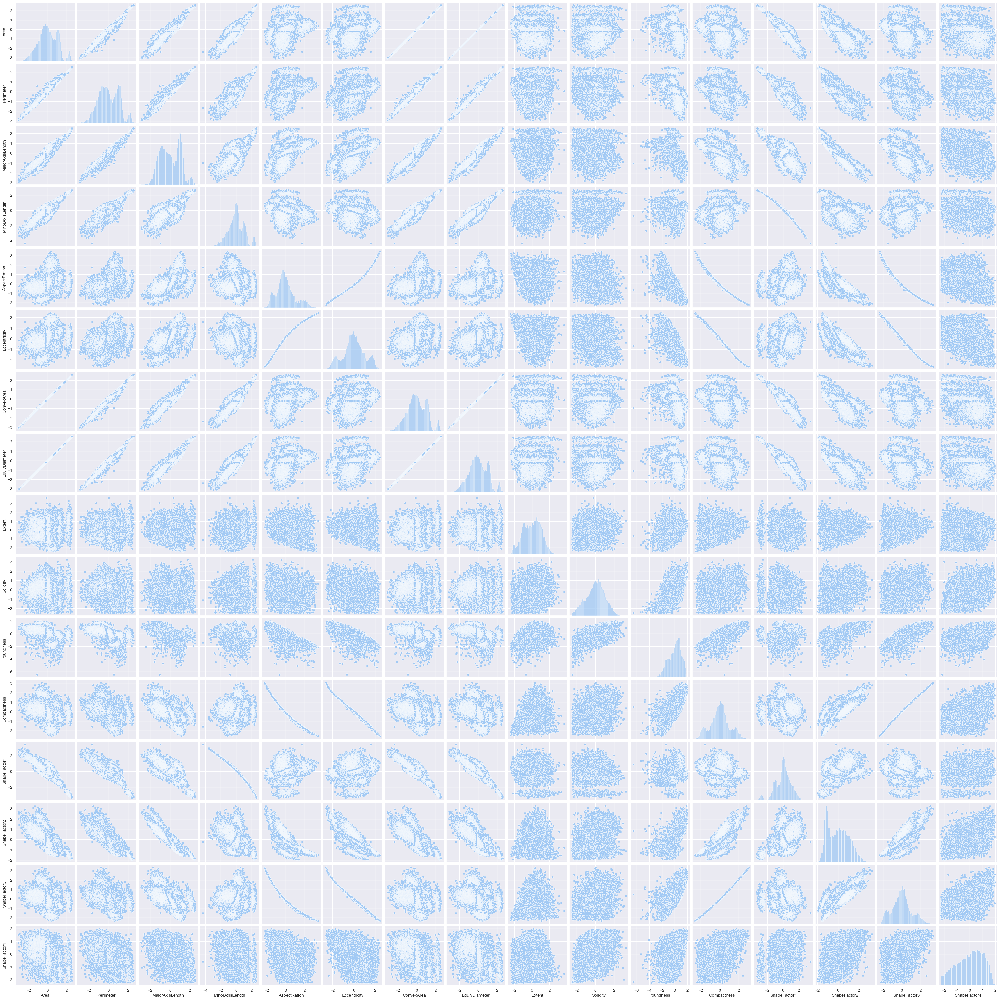

In [14]:
sns.pairplot(data_scaled)

# Clustering

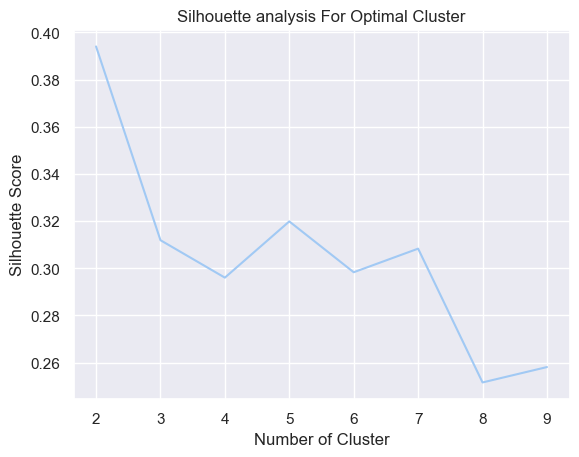

In [15]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

silhouette_avg = []

for num_clusters in range(2,10):
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)   
    kmeans.fit(data_scaled)
    cluster_labels = kmeans.labels_

    # silhouette score
    silhouette_avg.append(silhouette_score(data_scaled, cluster_labels))
    
sns.lineplot(x= range(2,10),
             y= silhouette_avg,
             markers='o')                                                                             
plt.xlabel('Number of Cluster') 
plt.ylabel('Silhouette Score') 
plt.title('Silhouette analysis For Optimal Cluster')
plt.show()

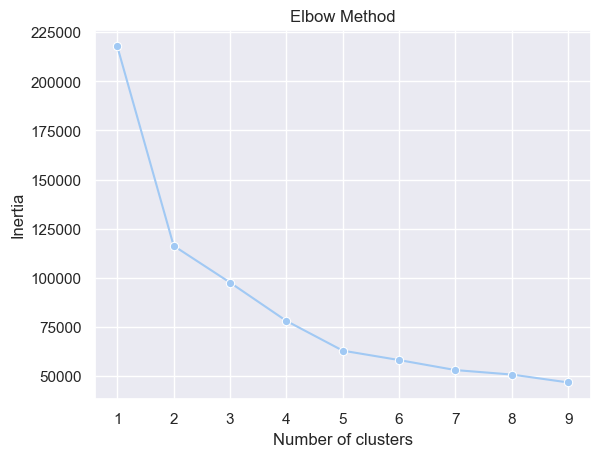

In [16]:
distortions = []
for num_clusters in range(1, 10):
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    kmeans.fit(data_scaled)
    distortions.append(kmeans.inertia_)

# Plot the elbow
sns.lineplot(x=range(1, 10),
             y=distortions,
             marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

The optimal cluster is 2 cluster

In [41]:
kmeans = KMeans(n_clusters=2, random_state=42)
kmeans.fit(data_scaled)
labels = kmeans.labels_

In [18]:
data_cluster=pd.concat([data,
                        pd.DataFrame({'cluster':labels})], axis=1)
data_cluster.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class,cluster
0,-1.571397,-1.688803,-1.996759,-0.685222,1.197191,-1.856936,-1.573016,-1.571397,0.159174,0.249764,0.958027,0.913358,0.007332,0.003147,0.834222,1.287266,SEKER,1
1,-1.523467,-1.372993,-2.249965,-0.334325,1.097356,-2.370929,-1.509413,-1.523467,0.681885,-0.816516,0.887034,0.953861,0.006979,0.003564,0.909851,1.113009,SEKER,1
2,-1.434910,-1.527191,-1.852350,-0.599726,1.209713,-1.786929,-1.439469,-1.434910,0.521982,0.505548,0.947849,0.908774,0.007244,0.003048,0.825871,1.501879,SEKER,1
3,-1.352138,-1.289303,-1.921978,-0.342391,1.153638,-2.094045,-1.306262,-1.352138,0.646211,-1.913219,0.903936,0.928329,0.007017,0.003215,0.861794,-0.624348,SEKER,1
4,-1.335138,-1.572804,-2.204741,-0.071072,1.060798,-2.516921,-1.344955,-1.335138,0.389833,1.058077,0.984877,0.970516,0.006697,0.003665,0.941900,1.566962,SEKER,1


c:\Users\USER\anaconda3\Lib\site-packages\seaborn\axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


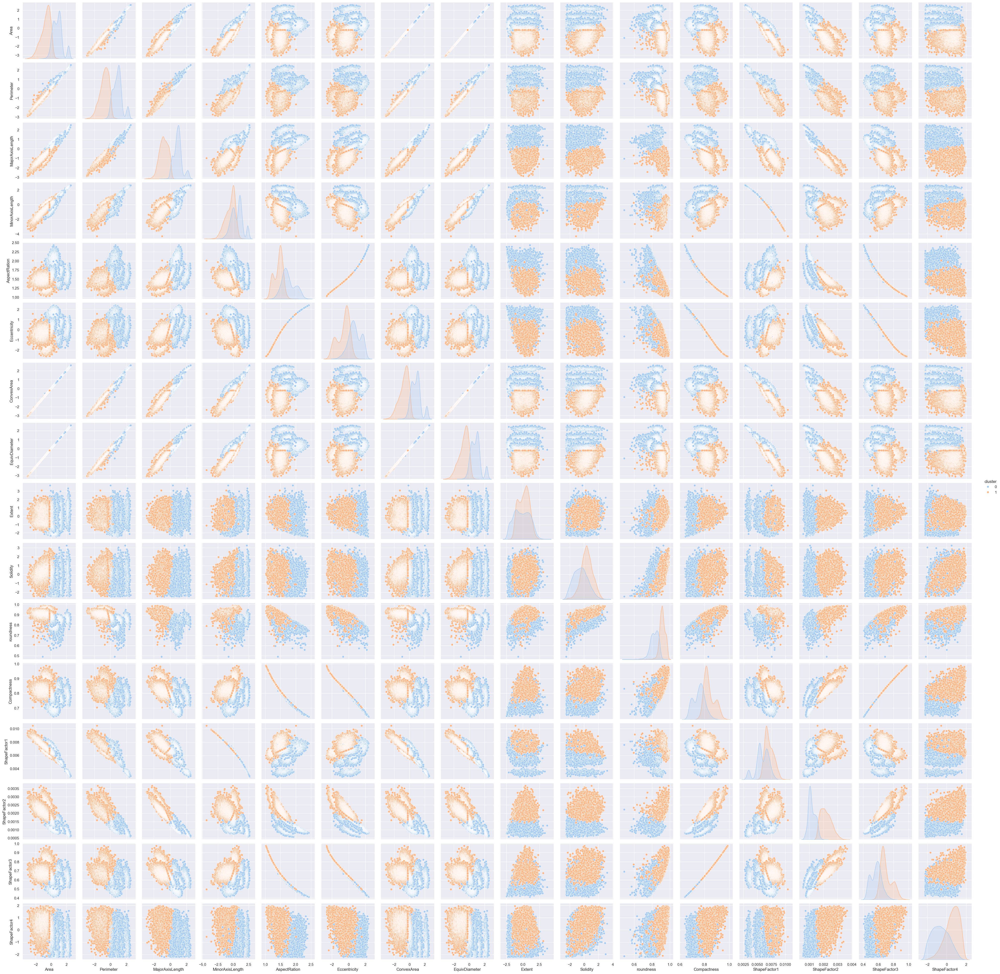

In [19]:
sns.pairplot(data_cluster, hue='cluster')

In [20]:
data1 = data
data1['cluster'] = labels
data1.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class,cluster
0,-1.571397,-1.688803,-1.996759,-0.685222,1.197191,-1.856936,-1.573016,-1.571397,0.159174,0.249764,0.958027,0.913358,0.007332,0.003147,0.834222,1.287266,SEKER,1
1,-1.523467,-1.372993,-2.249965,-0.334325,1.097356,-2.370929,-1.509413,-1.523467,0.681885,-0.816516,0.887034,0.953861,0.006979,0.003564,0.909851,1.113009,SEKER,1
2,-1.434910,-1.527191,-1.852350,-0.599726,1.209713,-1.786929,-1.439469,-1.434910,0.521982,0.505548,0.947849,0.908774,0.007244,0.003048,0.825871,1.501879,SEKER,1
3,-1.352138,-1.289303,-1.921978,-0.342391,1.153638,-2.094045,-1.306262,-1.352138,0.646211,-1.913219,0.903936,0.928329,0.007017,0.003215,0.861794,-0.624348,SEKER,1
4,-1.335138,-1.572804,-2.204741,-0.071072,1.060798,-2.516921,-1.344955,-1.335138,0.389833,1.058077,0.984877,0.970516,0.006697,0.003665,0.941900,1.566962,SEKER,1


In [21]:
px.scatter_3d(
    data1, 
    x='Area', 
    y='Perimeter', 
    z='Class',
    color='cluster',
    opacity=0.5
)

In [22]:
px.scatter_3d(
    data1, 
    x='Area', 
    y='Perimeter', 
    z='Class',
    color='cluster',
    opacity=0.5
)

In [23]:
px.scatter_3d(
    data1, 
    x='MajorAxisLength', 
    y='MinorAxisLength', 
    z='AspectRation',
    color='cluster',
    opacity=0.5
)

In [24]:
px.scatter_3d(
    data1, 
    x='MajorAxisLength', 
    y='MinorAxisLength', 
    z='AspectRation',
    color='cluster',
    opacity=0.5
)

In [25]:
px.scatter_3d(
    data1, 
    x='ShapeFactor1', 
    y='ShapeFactor2', 
    z='ShapeFactor3',
    color='cluster',
    opacity=0.5
)

In [26]:
px.scatter_3d(
    data1, 
    x='ShapeFactor4', 
    y='ShapeFactor2', 
    z='ShapeFactor3',
    color='cluster',
    opacity=0.5
)

In [35]:
from sklearn.decomposition import PCA

pca = PCA(3)
pca.fit(data_scaled)

loadings_df = pd.DataFrame(pca.components_, columns=data_scaled.columns)
loadings_df.T

,0,1,2
Area,-0.288241,-0.226309,-0.040493
Perimeter,-0.302182,-0.174806,-0.000088
MajorAxisLength,-0.316741,-0.080158,-0.085558
MinorAxisLength,-0.203374,-0.392672,0.046729
AspectRation,-0.240279,0.315695,-0.197942
Eccentricity,-0.245840,0.314854,-0.178733
ConvexArea,-0.289020,-0.224335,-0.032315
EquivDiameter,-0.288241,-0.226309,-0.040493
Extent,0.051495,-0.190676,-0.366092
Solidity,0.144157,-0.126001,-0.749087


PCA 1 :
- Area
- Perimeter
- MajorAxisLength
- ConvexArea
- EquivDiameter
- roundness
- ShapeFactor2

PCA 2 :
- MinorAxisLength
- AspecRation
- Eccentricity
- Compactness
- ShapeFactor1
- ShapeFactor3

PCA 3 :
- Solidity

PCA 4 :
- Extent
- ShapeFactor4

In [43]:
reduced_df = pd.DataFrame(pca.transform(data_scaled), columns=['PC1', 'PC2', 'PC3'])
reduced_df['Cluster'] = labels
reduced_df

,PC1,PC2,PC3,Cluster
0,5.988646,-0.866780,0.889256,1
1,6.112022,-1.732647,2.368000,1
2,5.682400,-1.054004,0.449083,1
3,4.832174,-1.107428,3.297658,1
4,6.949002,-2.839801,0.724583,1
...,...,...,...,...
13606,0.980996,0.163435,-0.741636,1
13607,1.488580,-0.798664,-1.317860,1
13608,1.175042,-0.366016,-0.174286,1
13609,0.765266,0.025893,0.680435,1


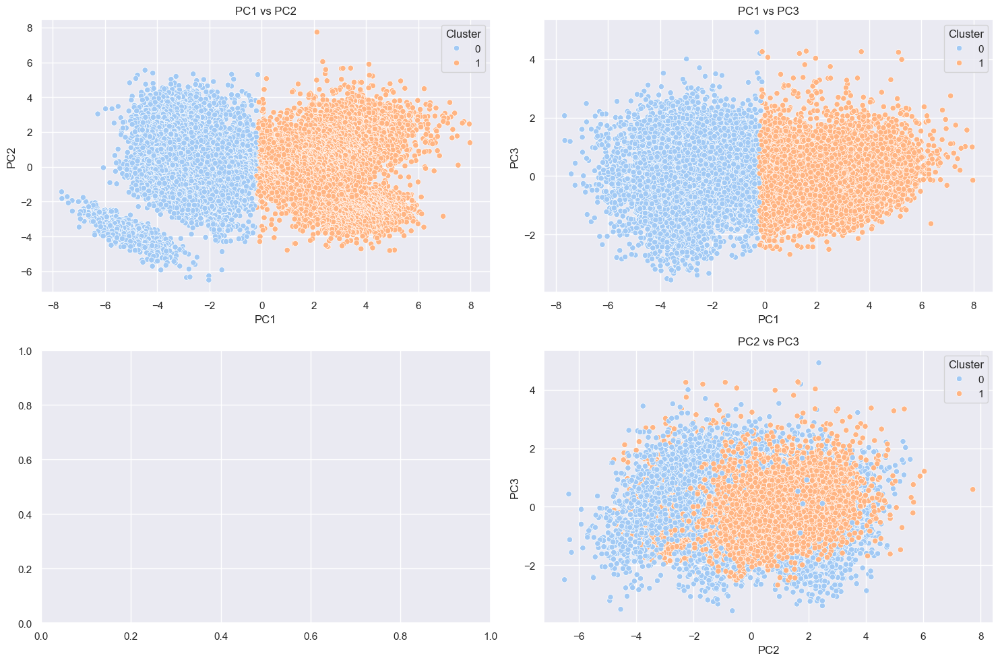

In [44]:
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
axes = axes.flatten()

sns.scatterplot(data=reduced_df, x='PC1', y='PC2', hue='Cluster', ax=axes[0])
axes[0].set_title('PC1 vs PC2')

# Additional scatter plots for other combinations (modify as needed)
sns.scatterplot(data=reduced_df, x='PC1', y='PC3', hue='Cluster', ax=axes[1])
axes[1].set_title('PC1 vs PC3')

sns.scatterplot(data=reduced_df, x='PC2', y='PC3', hue='Cluster', ax=axes[3])
axes[3].set_title('PC2 vs PC3')


plt.tight_layout()
plt.show()